### Visual Curiosity Heatmaps (Gaussian + Saliency, bbox-weighted)
This notebook generates hybrid curiosity heatmaps for 5 images from each domain.


In [1]:
# Imports
import json
import numpy as np
import cv2
import matplotlib.pyplot as plt
from pathlib import Path
from scipy.ndimage import gaussian_filter

print('Imports loaded')


Imports loaded


In [2]:
# Robust annotation loader (handles different keys, encodings, score types)

def load_json_any_encoding(path):
    encodings = ['utf-8', 'utf-8-sig', 'utf-16', 'utf-16-le', 'utf-16-be',
                 'utf-32', 'utf-32-le', 'utf-32-be', 'cp1252', 'latin1']
    raw = Path(path).read_bytes()
    for enc in encodings:
        try:
            return json.loads(raw.decode(enc))
        except Exception:
            continue
    raise ValueError(f'Failed to decode JSON: {path}')


def load_domain_annotations(domain_dir):
    ann_path = Path(domain_dir) / 'annotations.json'
    data = load_json_any_encoding(str(ann_path))
    key = 'annotations' if 'annotations' in data else ('images' if 'images' in data else None)
    if key is None:
        raise KeyError(f'No annotations/images key in {ann_path}')
    items = data[key]
    # Normalize curiosity_score to float if present as string
    for img_entry in items:
        for a in img_entry.get('annotations', []):
            try:
                a['attributes']['curiosity_score'] = float(a['attributes']['curiosity_score'])
            except Exception:
                pass
    return items


In [3]:
# Spectral Residual Saliency (no opencv-contrib)

def spectral_residual_saliency(image_path, small_size=256, blur_sigma=3):
    img = cv2.imread(str(image_path))
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).astype(np.float32)
    h, w = gray.shape
    g_small = cv2.resize(gray, (small_size, small_size))
    F = np.fft.fft2(g_small)
    A = np.abs(F); P = np.angle(F)
    logA = np.log(A + 1e-8)
    logA_sm = cv2.blur(logA, (3, 3))
    SR = logA - logA_sm
    recon = np.fft.ifft2(np.exp(SR + 1j * P))
    S = np.abs(recon).astype(np.float32)
    S = cv2.GaussianBlur(S, (0, 0), blur_sigma)
    S = cv2.resize(S, (w, h))
    S = (S - S.min()) / (S.max() - S.min() + 1e-8)
    return S


## What is "G-attended Saliency"?

**G-attended Saliency** = Full-image saliency **amplified inside bounding boxes**

### How it works:
1. **Full-image Saliency (S)**: Compute saliency on the **entire image** - detects all visually striking areas (contrast, edges, textures)
2. **Amplification Map (W)**: Create weights that are:
   - **HIGH (~2.0x) inside bounding boxes** → amplifies saliency
   - **LOW (~0.15x) outside bounding boxes** → reduces saliency
3. **G-attended Saliency = W × S**: Multiply full saliency by amplification map

### Result:
- Saliency is present **everywhere** in the image
- But it's **stronger/brighter inside curiosity regions** (your bounding boxes)
- Outside boxes, saliency is **diminished but not zero** (provides context)

This bridges **low-level visual attention** (saliency) with **high-level curiosity** (your annotations)!


In [4]:
# Gaussian curiosity map from bounding boxes

def gaussian_heatmap(width, height, annotations, sigma_divisor=4, score_scaling='quadratic', combine='max', post_blur=1):
    H = np.zeros((height, width), dtype=np.float32)
    for ann in annotations:
        xtl, ytl = float(ann['xtl']), float(ann['ytl'])
        xbr, ybr = float(ann['xbr']), float(ann['ybr'])
        score = float(ann['attributes'].get('curiosity_score', 0.0))
        cx, cy = (xtl + xbr) / 2, (ytl + ybr) / 2
        sx, sy = max((xbr - xtl) / sigma_divisor, 1e-3), max((ybr - ytl) / sigma_divisor, 1e-3)
        if score_scaling == 'linear':
            amp = score / 5.0
        elif score_scaling == 'quadratic':
            amp = (score / 5.0) ** 1.5
        else:
            amp = (np.exp(score) - 1) / (np.exp(5) - 1)
        x0 = int(max(0, cx - 3 * sx)); x1 = int(min(width,  cx + 3 * sx))
        y0 = int(max(0, cy - 3 * sy)); y1 = int(min(height, cy + 3 * sy))
        yy, xx = np.ogrid[y0:y1, x0:x1]
        g = amp * np.exp(-(((xx - cx) ** 2) / (2 * sx ** 2) + ((yy - cy) ** 2) / (2 * sy ** 2)))
        if combine == 'max':
            H[y0:y1, x0:x1] = np.maximum(H[y0:y1, x0:x1], g)
        else:
            H[y0:y1, x0:x1] += g
    if H.max() > 0:
        H = (H - H.min()) / (H.max() - H.min())
    if post_blur > 0:
        H = gaussian_filter(H, sigma=post_blur)
        if H.max() > 0:
            H = (H - H.min()) / (H.max() - H.min())
    return H


def box_mask(width, height, annotations, soft_sigma=8):
    M = np.zeros((height, width), dtype=np.float32)
    for ann in annotations:
        xtl, ytl = int(ann['xtl']), int(ann['ytl'])
        xbr, ybr = int(ann['xbr']), int(ann['ybr'])
        M[ytl:ybr, xtl:xbr] = 1.0
    if soft_sigma > 0:
        M = gaussian_filter(M, sigma=soft_sigma)
        if M.max() > 0:
            M = (M - M.min()) / (M.max() - M.min())
    return M


In [5]:
# Hybrid: Gaussian prior + full-image saliency, AMPLIFIED inside boxes

def hybrid_curiosity(image_path, img_entry, alpha=0.8, beta=0.2, lambda_out=0.15, 
                     saliency_boost_inside=2.0):
    """
    G-attended Saliency Explanation:
    - Compute full-image saliency S (applies to entire image)
    - Inside bounding boxes: AMPLIFY saliency by boost factor (higher focus)
    - Outside bounding boxes: REDUCE saliency by lambda_out (lower focus)
    - Result: Saliency everywhere, but STRONGER inside curiosity regions
    """
    w, h = int(img_entry['width']), int(img_entry['height'])
    anns = img_entry.get('annotations', [])

    # 1. Gaussian curiosity map (from annotations)
    G = gaussian_heatmap(w, h, anns, sigma_divisor=4, score_scaling='quadratic', combine='max', post_blur=1)
    
    # 2. Full-image saliency (computed on entire image)
    S = spectral_residual_saliency(image_path)
    
    # 3. Create amplification map: HIGH inside boxes, LOW outside
    # Inside boxes (where G is high): weight ≈ saliency_boost_inside (amplified)
    # Outside boxes (where G is low): weight ≈ lambda_out (reduced)
    M_amplify = box_mask(w, h, anns, soft_sigma=8)  # Soft mask for smooth transitions
    W = lambda_out + (saliency_boost_inside - lambda_out) * M_amplify
    
    # 4. G-attended Saliency: Full-image saliency with amplification inside boxes
    S_att = W * S
    
    # 5. Final hybrid: Combine Gaussian curiosity + amplified saliency
    C = alpha * G + beta * S_att
    if C.max() > 0:
        C = (C - C.min()) / (C.max() - C.min())
    
    return G, S, S_att, C, W


In [6]:
# Batch process ALL images (200 total) and save heatmap OVERLAY on original images

import os
from pathlib import Path
import matplotlib.cm as cm

# Create output directory
output_dir = Path('heatmap')
output_dir.mkdir(exist_ok=True)
print(f'Created output directory: {output_dir}')

# Parameters
alpha, beta, lambda_out, boost = 0.8, 0.2, 0.15, 2.0
overlay_alpha = 0.6  # Transparency for heatmap overlay

# Get jet colormap for colored heatmaps
jet_colormap = cm.get_cmap('jet')

domains = [
    'Domain_1_Images',
    'Domain_2_Images',
    'Domain_3_Images',
    'Domain_4_Images',
    'Domain_5_Images',
]

all_processed = []

for domain in domains:
    print(f'\nProcessing {domain}...')
    items = load_domain_annotations(domain)
    items_sorted = sorted(items, key=lambda x: x['name'])
    
    for img_entry in items_sorted:
        img_path = Path(domain) / img_entry['name']
        
        if not img_path.exists():
            print(f'  ⚠ Skipping {img_entry["name"]} (file not found)')
            continue
        
        # Generate hybrid heatmap
        try:
            # Load original image
            img_bgr = cv2.imread(str(img_path))
            img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
            
            G, S, S_att, C, W = hybrid_curiosity(str(img_path), img_entry, 
                                                  alpha=alpha, beta=beta, 
                                                  lambda_out=lambda_out, 
                                                  saliency_boost_inside=boost)
            
            # Extract number from filename (e.g., img_001.png -> 001)
            img_num = img_entry['name'].replace('img_', '').replace('.png', '')
            output_name = f'img_heatmap_{img_num}.png'
            output_path = output_dir / output_name
            
            # Create overlay: original image + colored heatmap with transparency
            # Apply jet colormap to heatmap
            C_colored = jet_colormap(C)[:, :, :3]  # Get RGB (remove alpha channel)
            
            # Blend original image with heatmap overlay
            overlay = (overlay_alpha * C_colored + (1 - overlay_alpha) * img_rgb / 255.0)
            overlay_uint8 = np.clip(overlay * 255, 0, 255).astype(np.uint8)
            
            # Convert RGB to BGR for OpenCV
            overlay_bgr = cv2.cvtColor(overlay_uint8, cv2.COLOR_RGB2BGR)
            cv2.imwrite(str(output_path), overlay_bgr)
            
            all_processed.append((img_entry['name'], output_name))
        except Exception as e:
            print(f'   Error processing {img_entry["name"]}: {e}')
            continue

print(f'\n Successfully processed {len(all_processed)} heatmap overlays')
print(f'   Saved to: {output_dir}/')
print(f'\nFirst 5 saved:')
for orig, saved in all_processed[:5]:
    print(f'   {orig} → {saved}')


Created output directory: heatmap

Processing Domain_1_Images...


C:\Users\utsag\AppData\Local\Temp\ipykernel_45712\1656961441.py:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  jet_colormap = cm.get_cmap('jet')



Processing Domain_2_Images...

Processing Domain_3_Images...

Processing Domain_4_Images...

Processing Domain_5_Images...

 Successfully processed 200 heatmap overlays
   Saved to: heatmap/

First 5 saved:
   img_001.png → img_heatmap_001.png
   img_002.png → img_heatmap_002.png
   img_003.png → img_heatmap_003.png
   img_004.png → img_heatmap_004.png
   img_005.png → img_heatmap_005.png


Processing Domain_1_Images ...


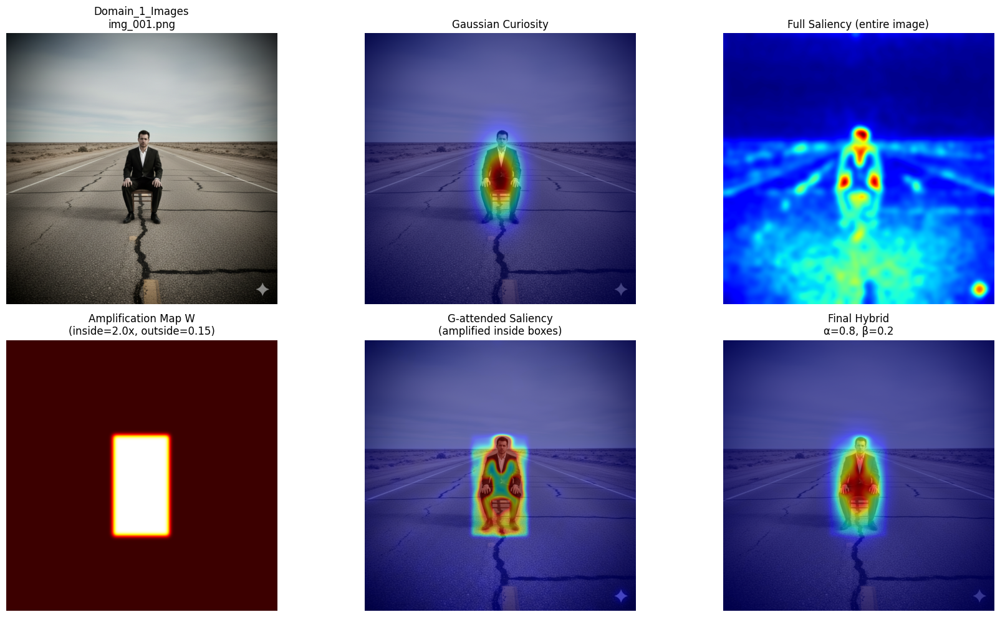

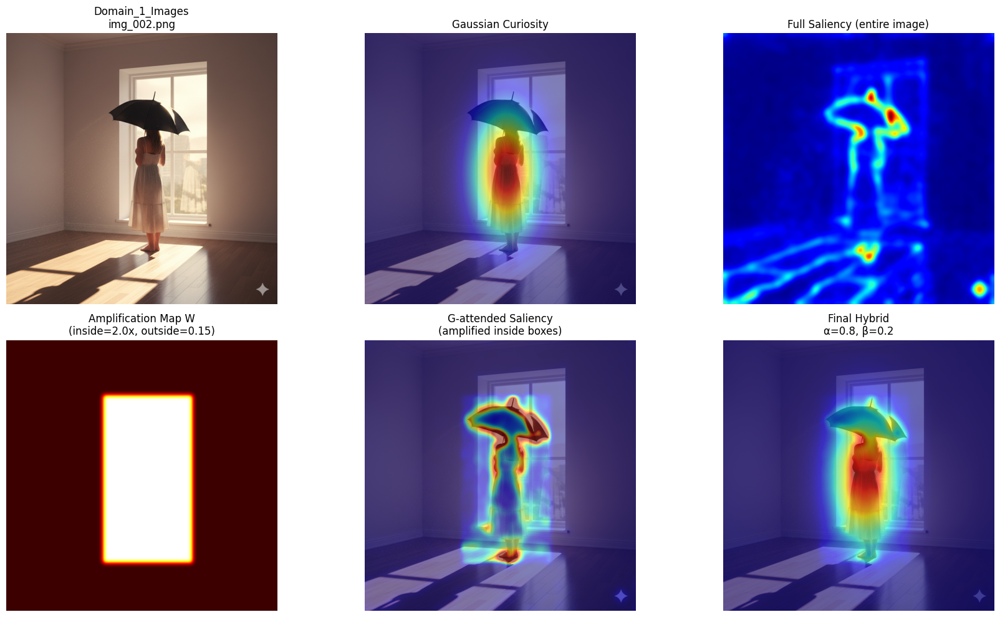

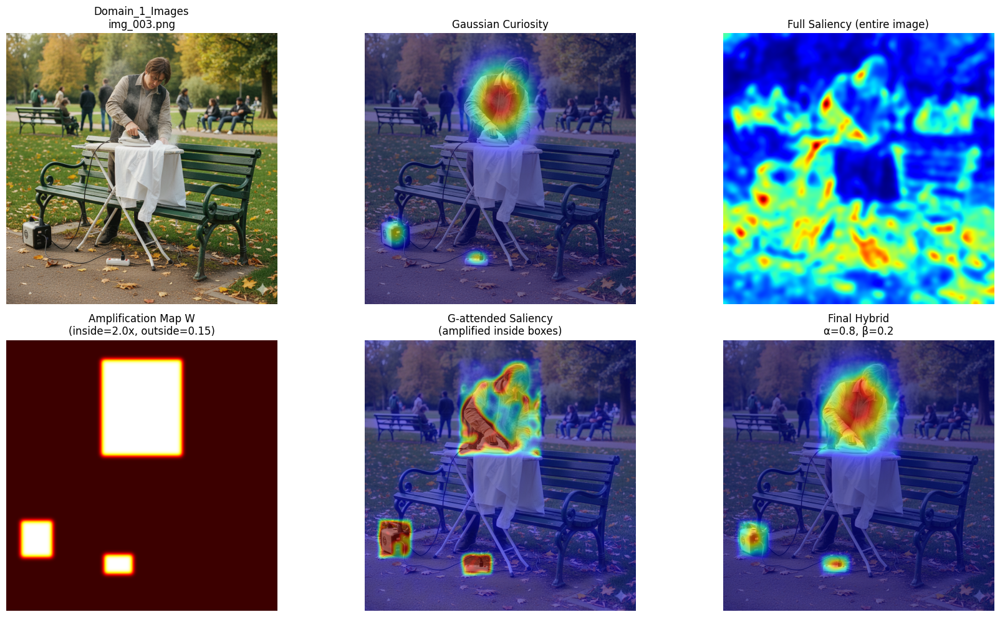

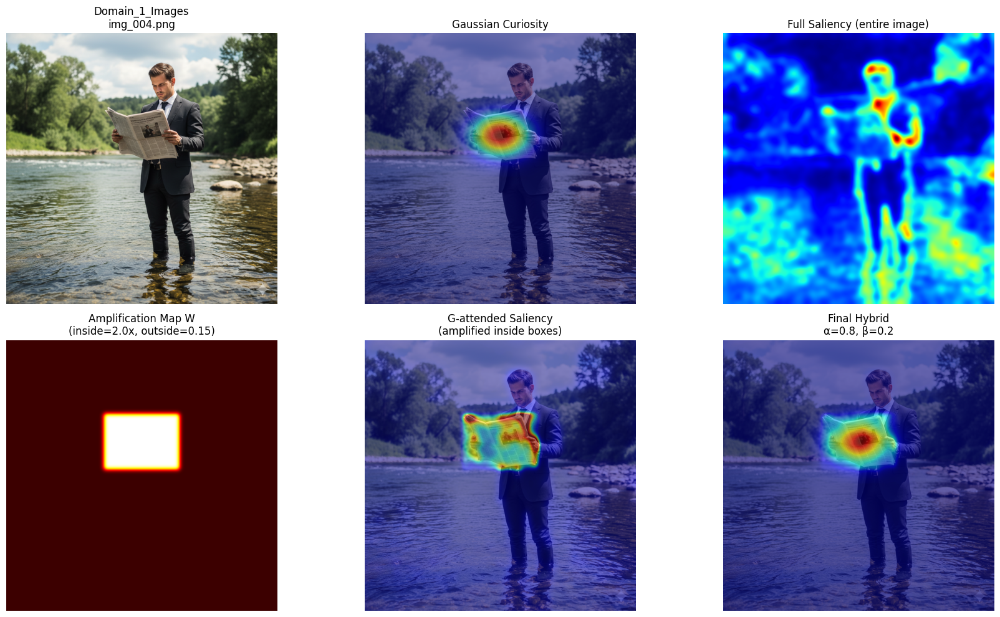

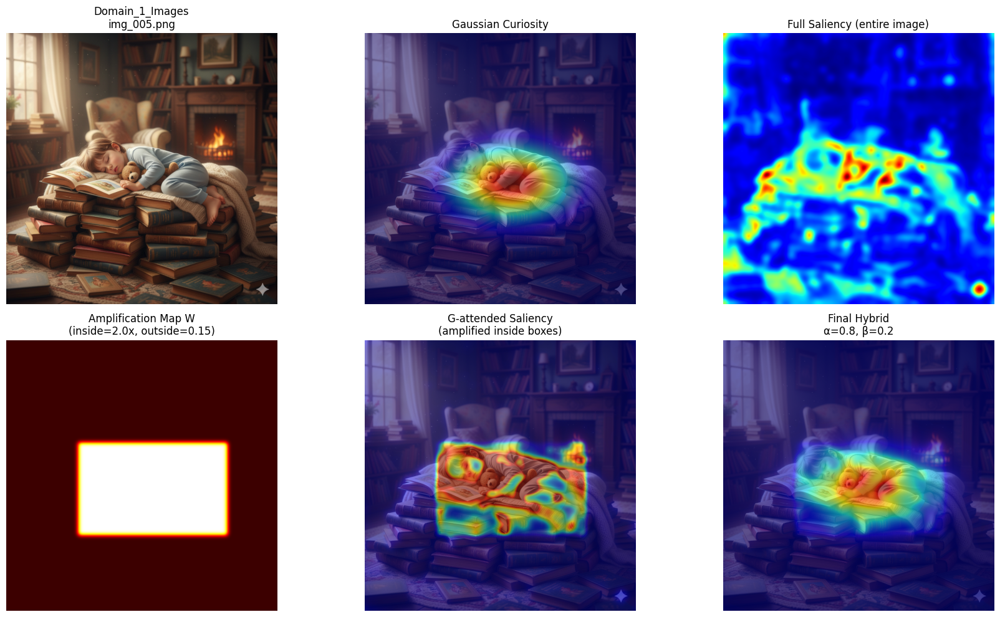

Processing Domain_2_Images ...


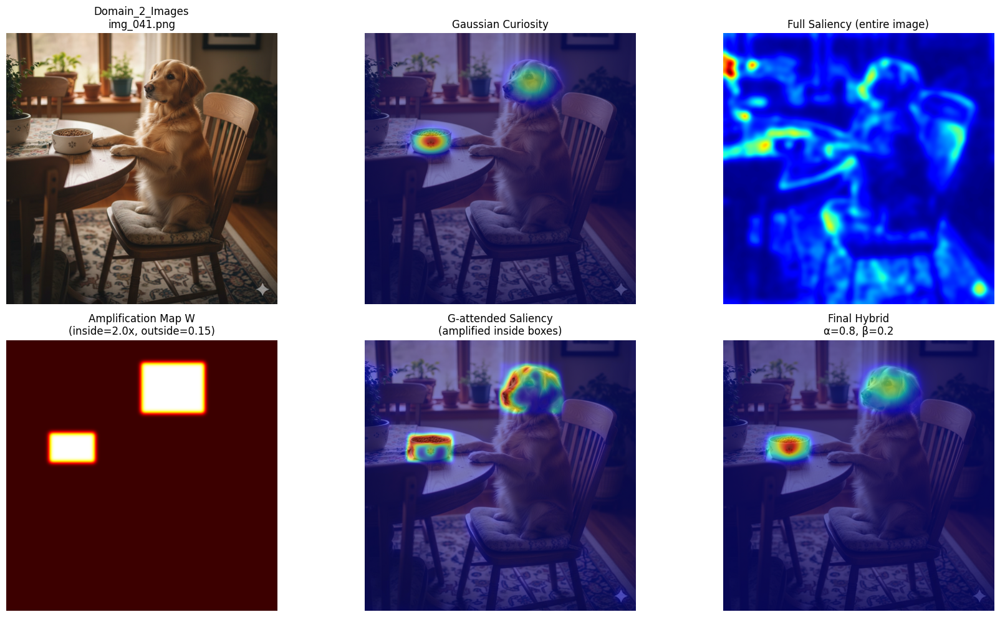

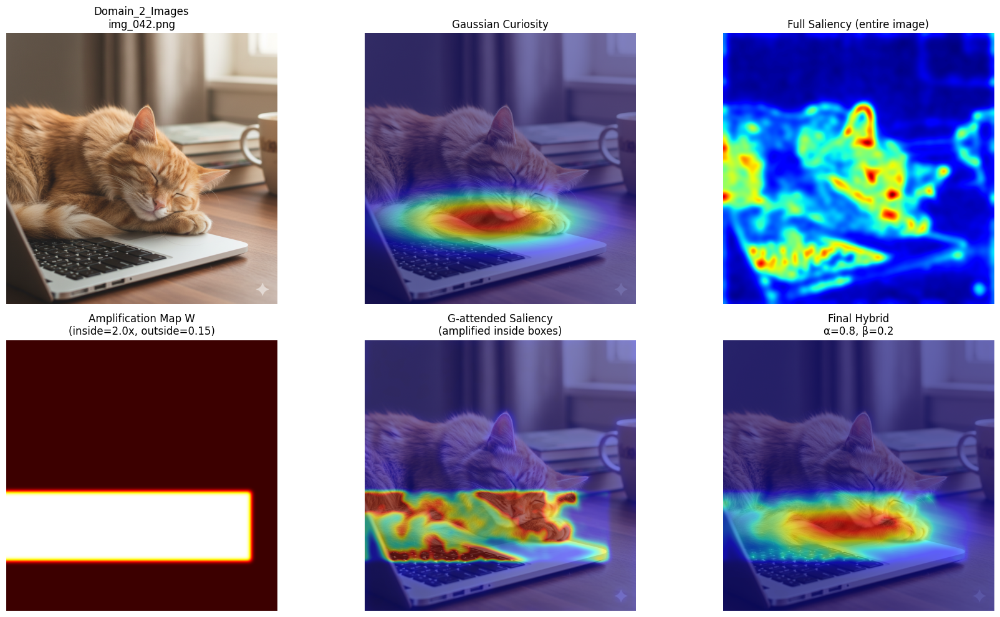

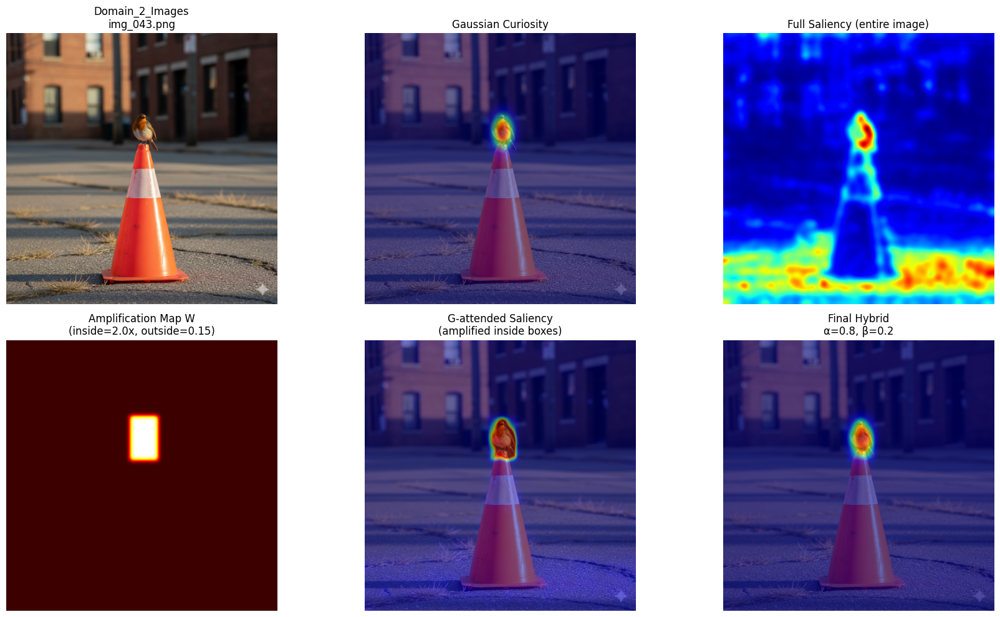

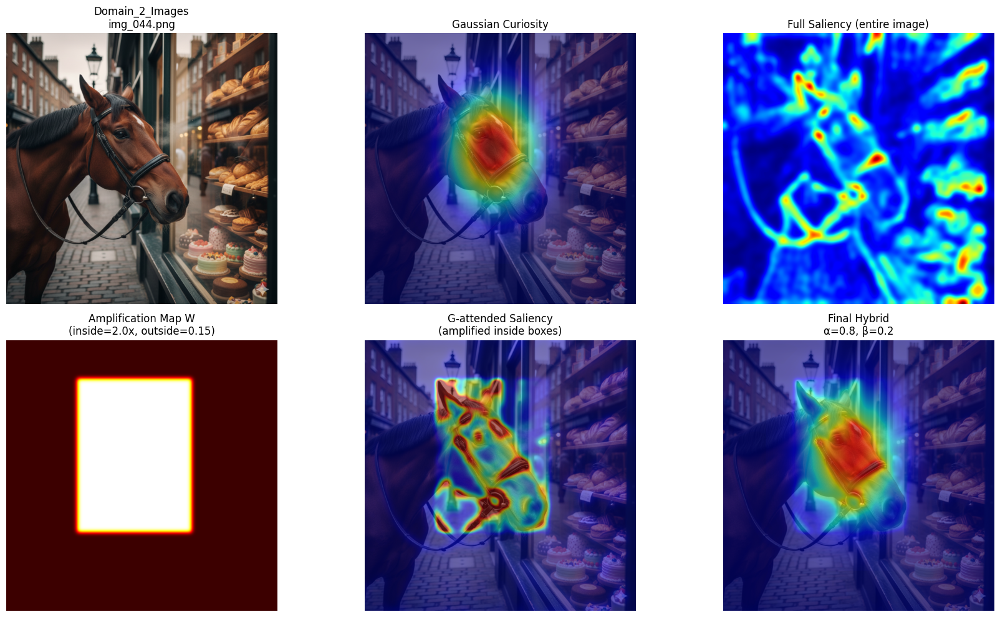

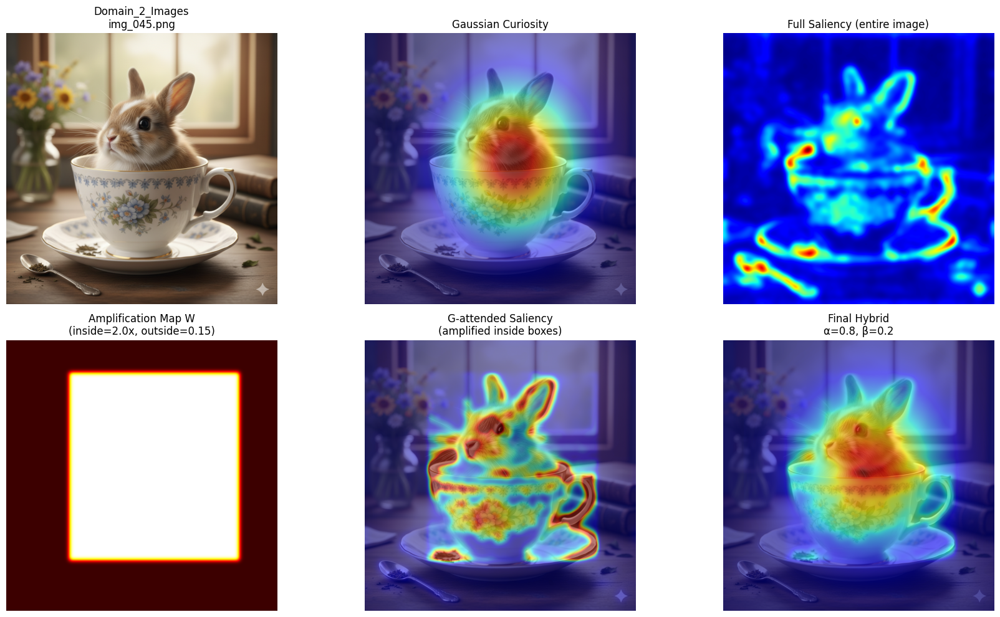

Processing Domain_3_Images ...


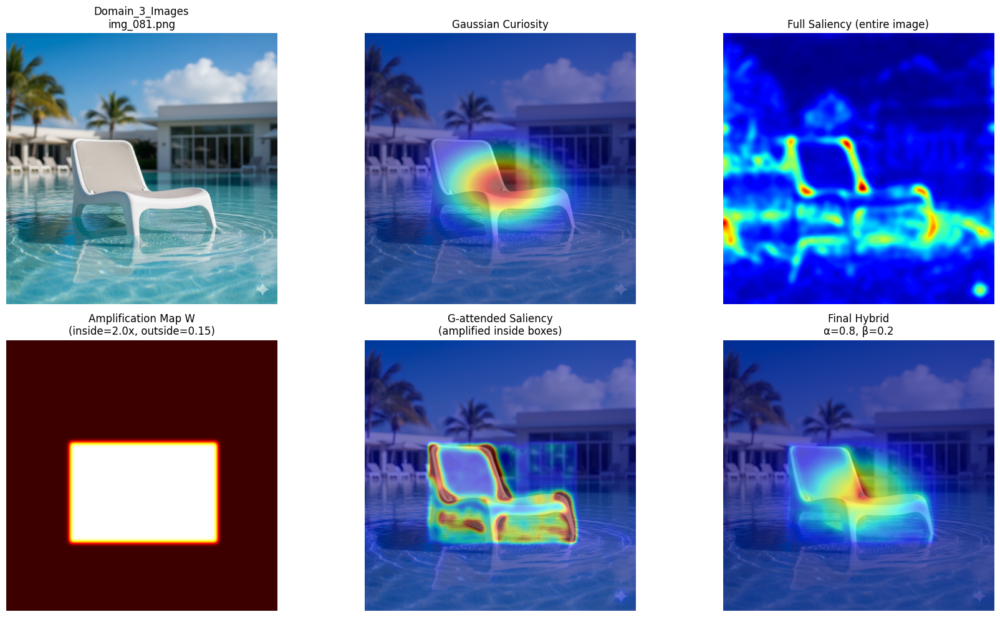

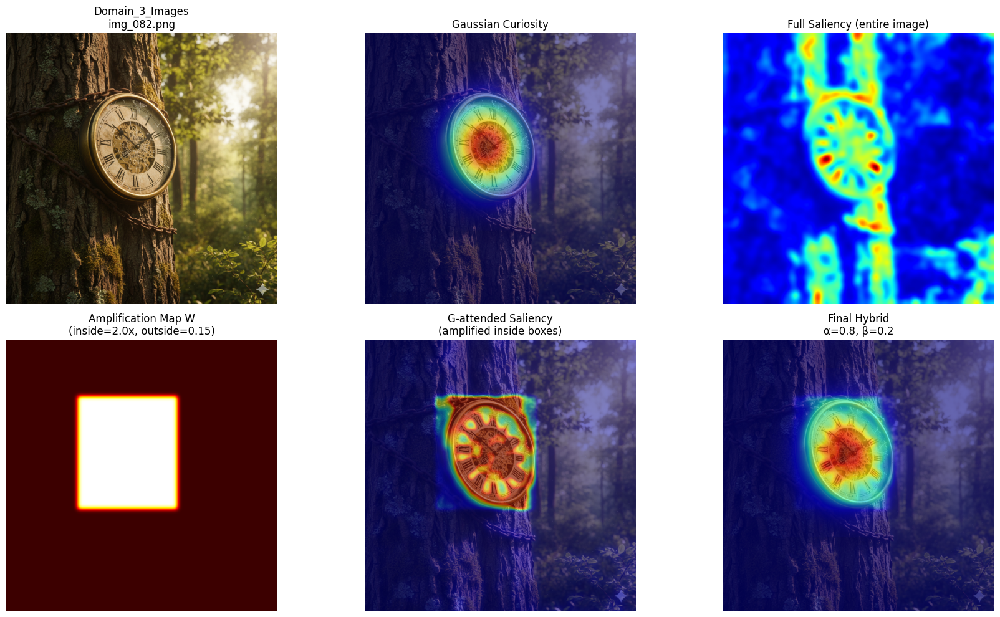

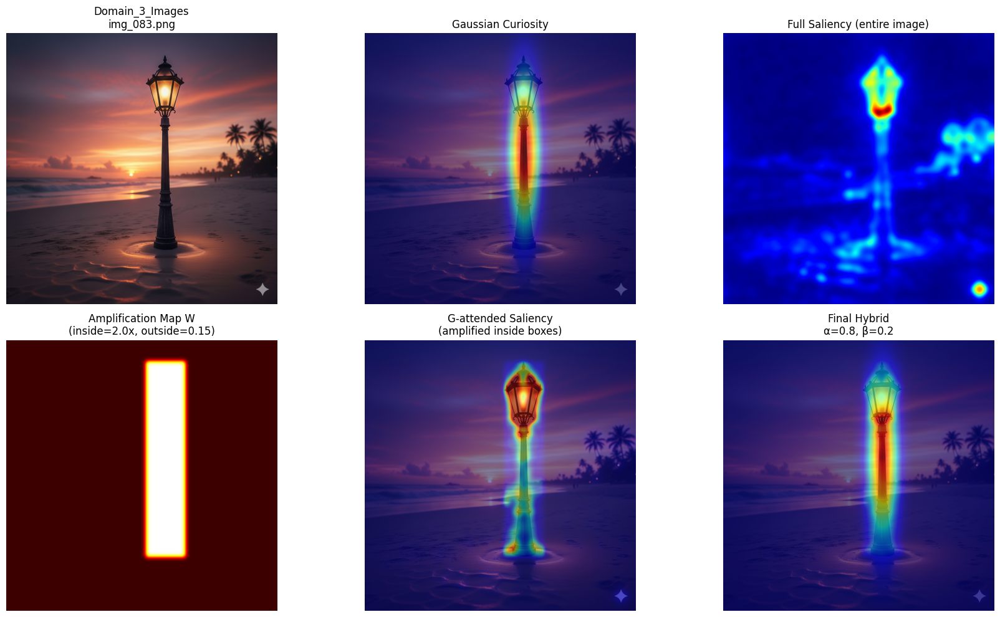

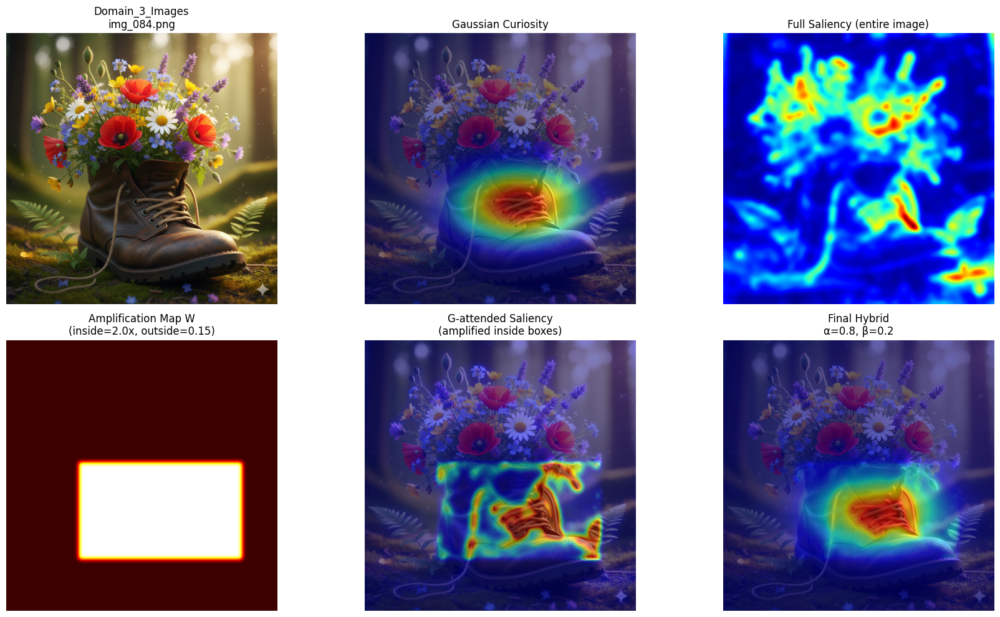

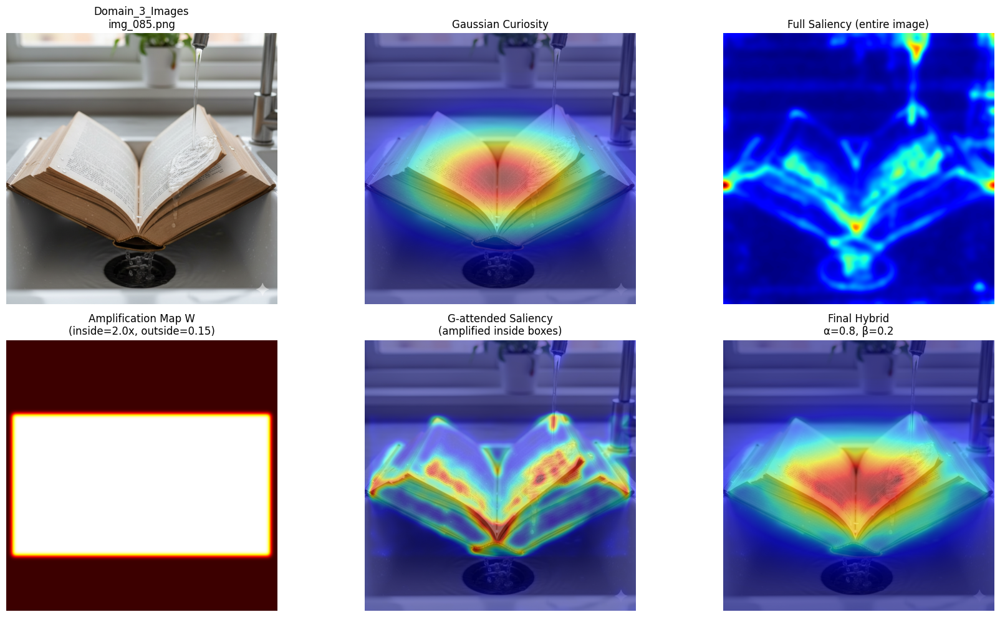

Processing Domain_4_Images ...


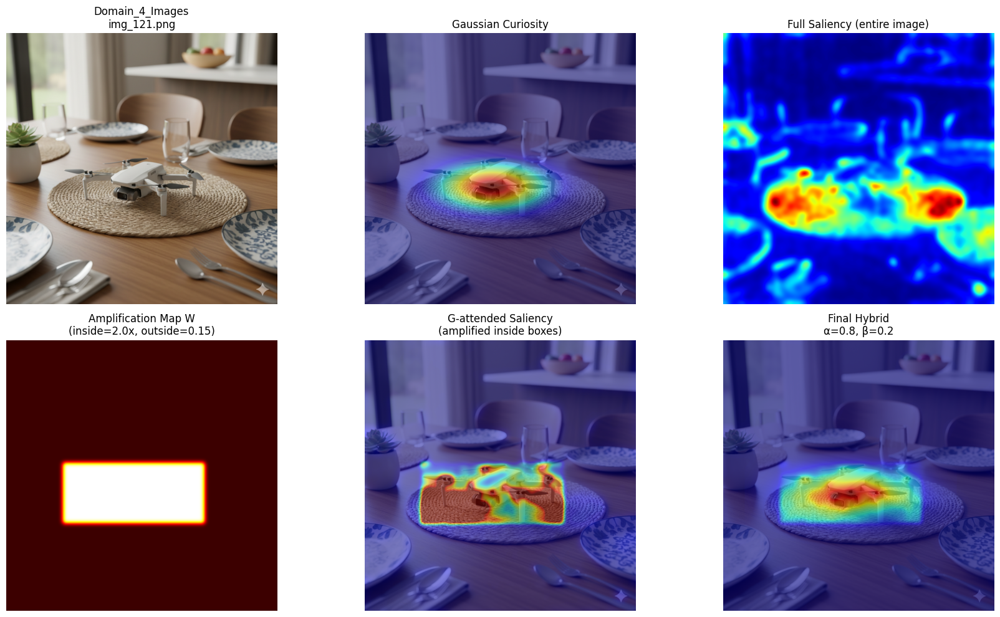

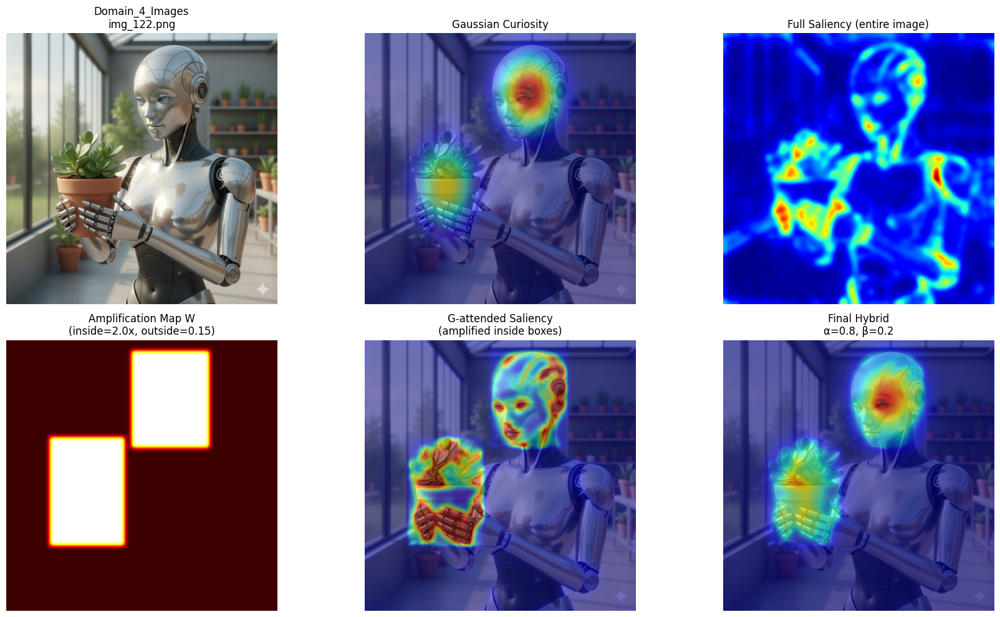

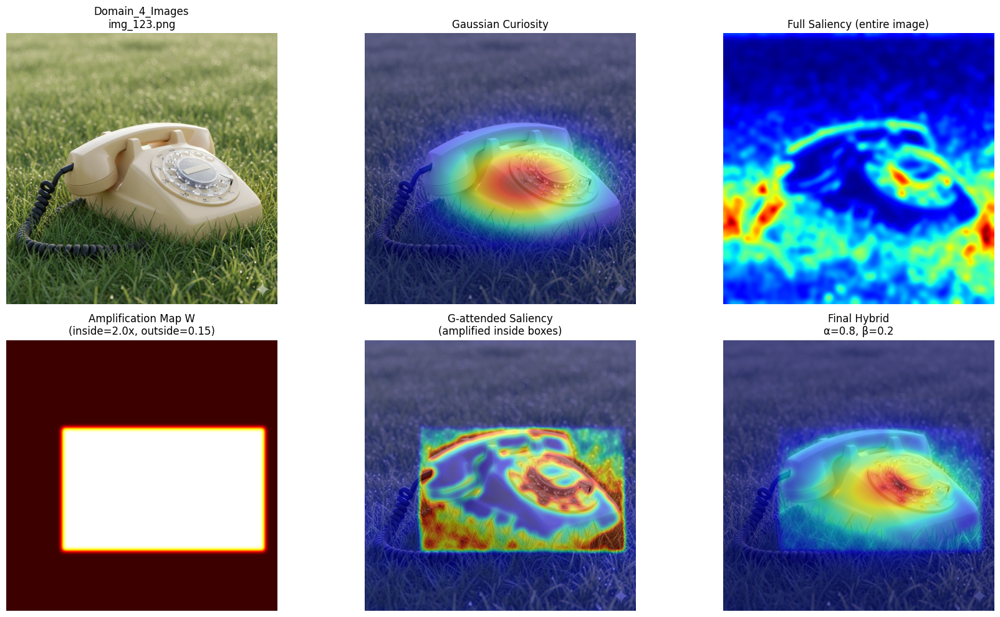

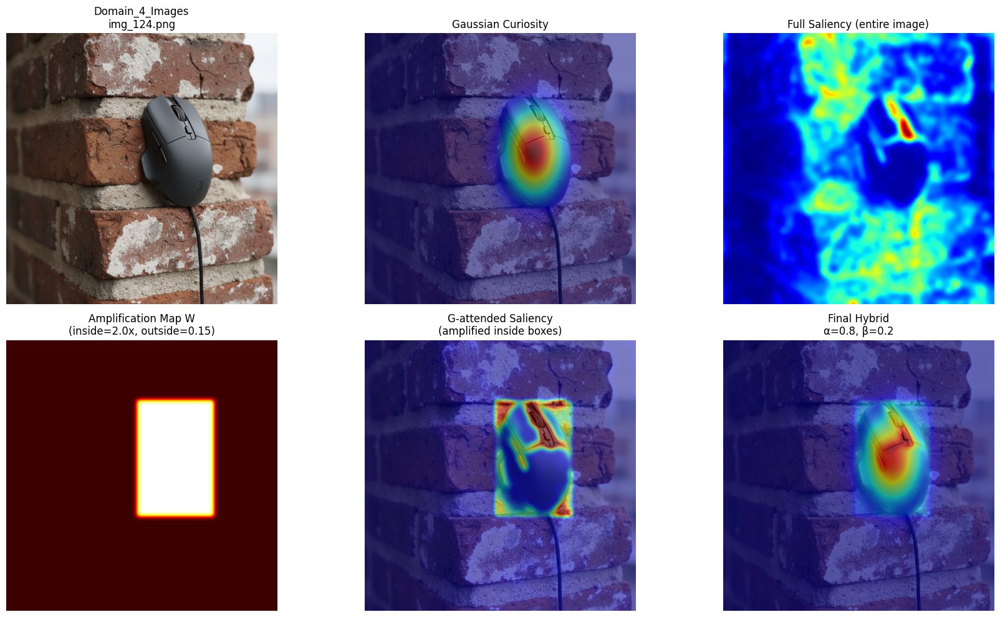

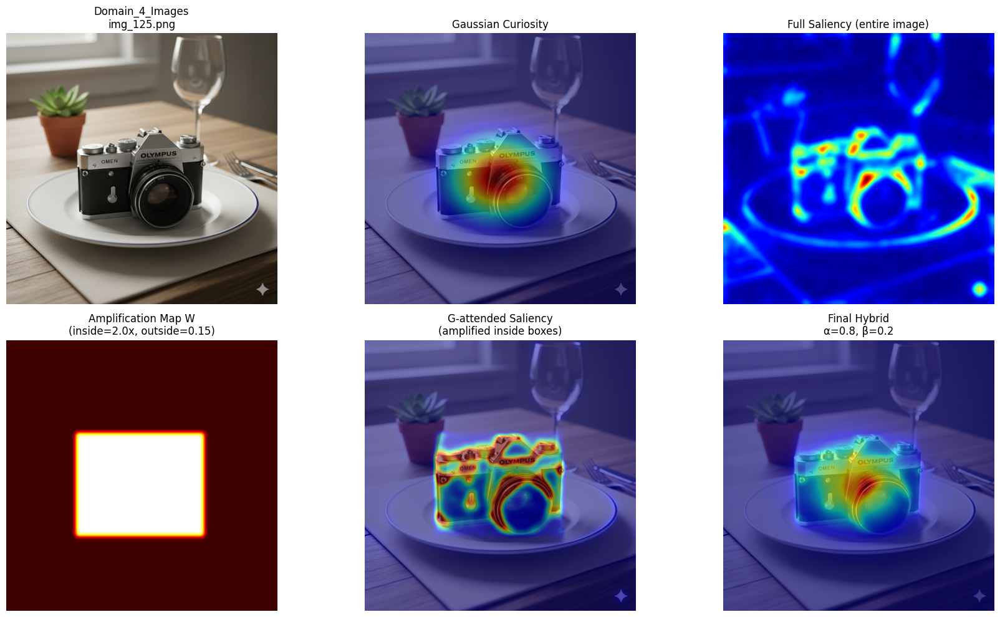

Processing Domain_5_Images ...


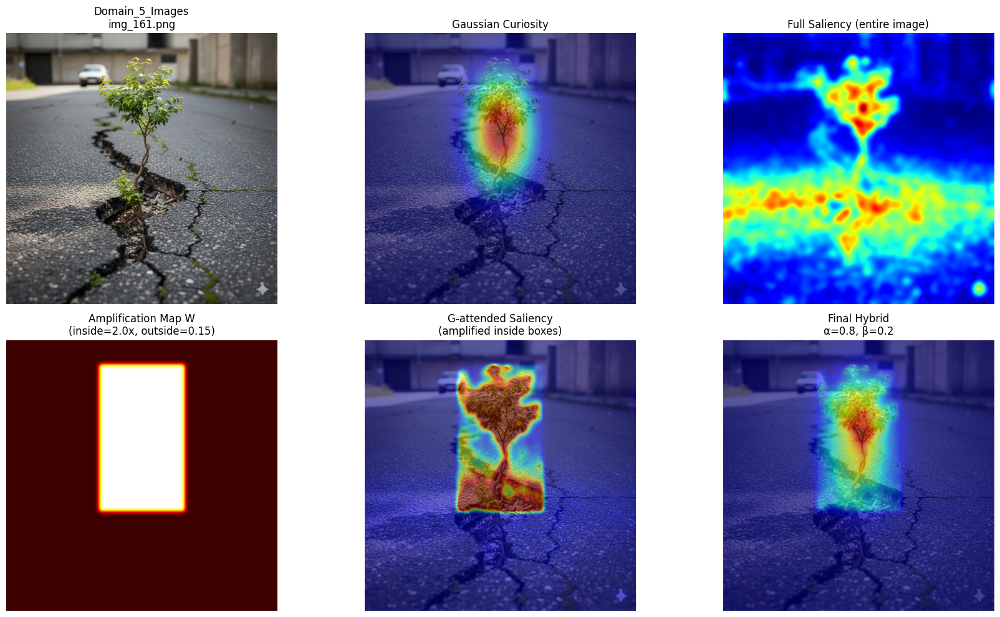

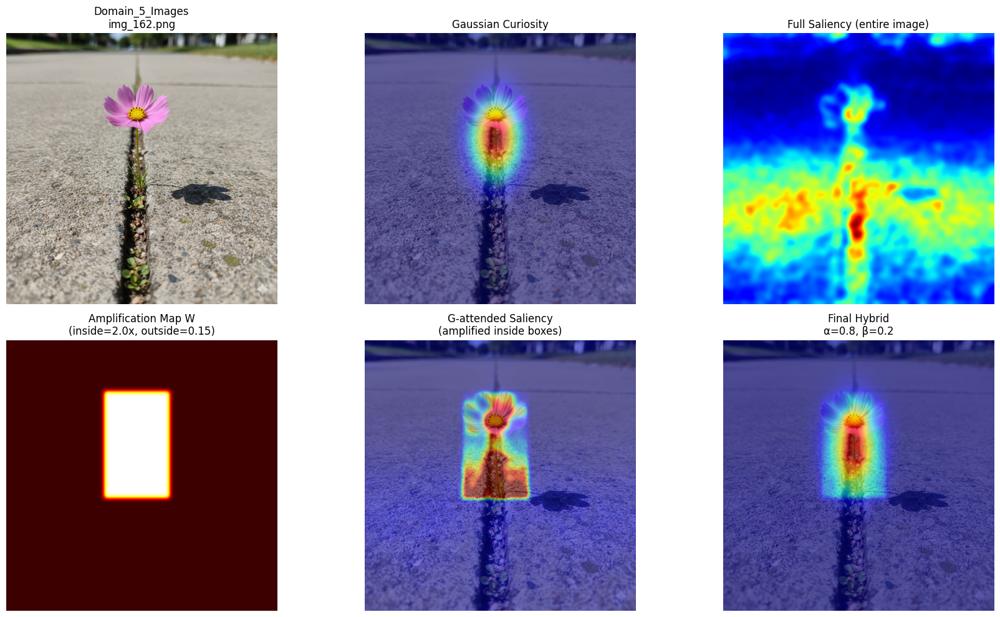

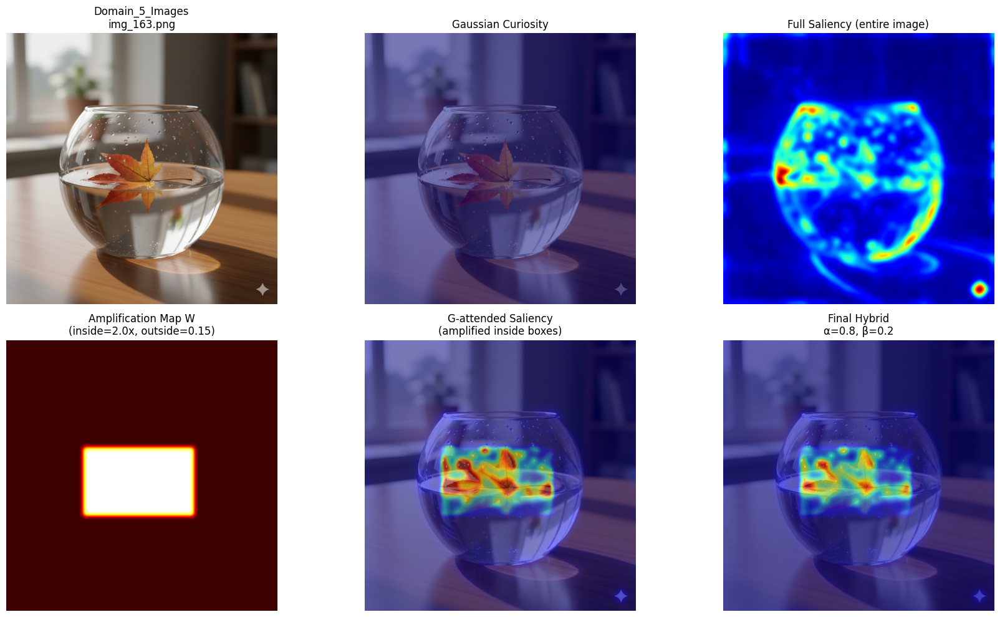

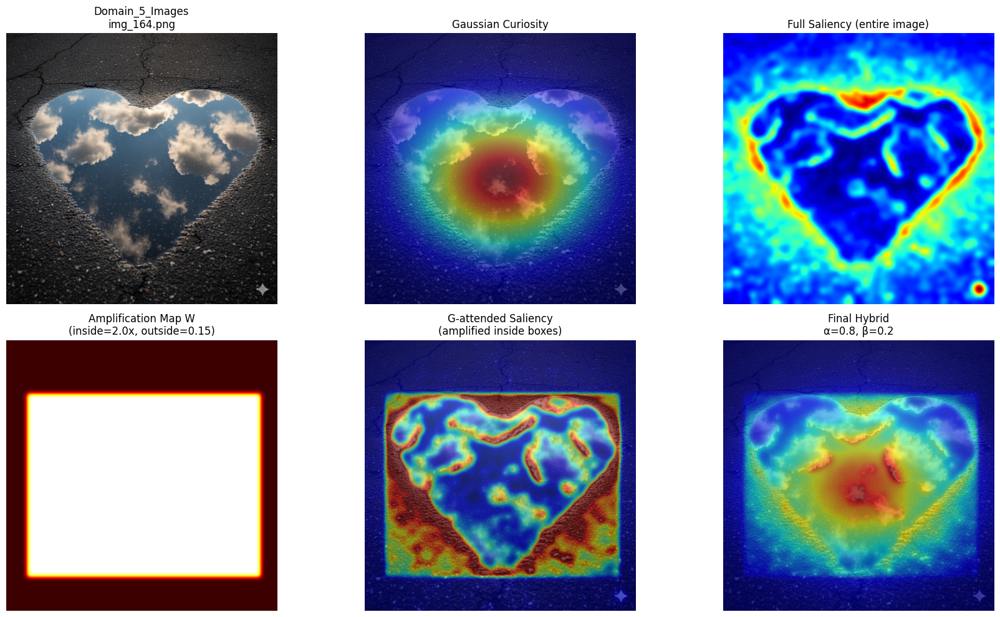

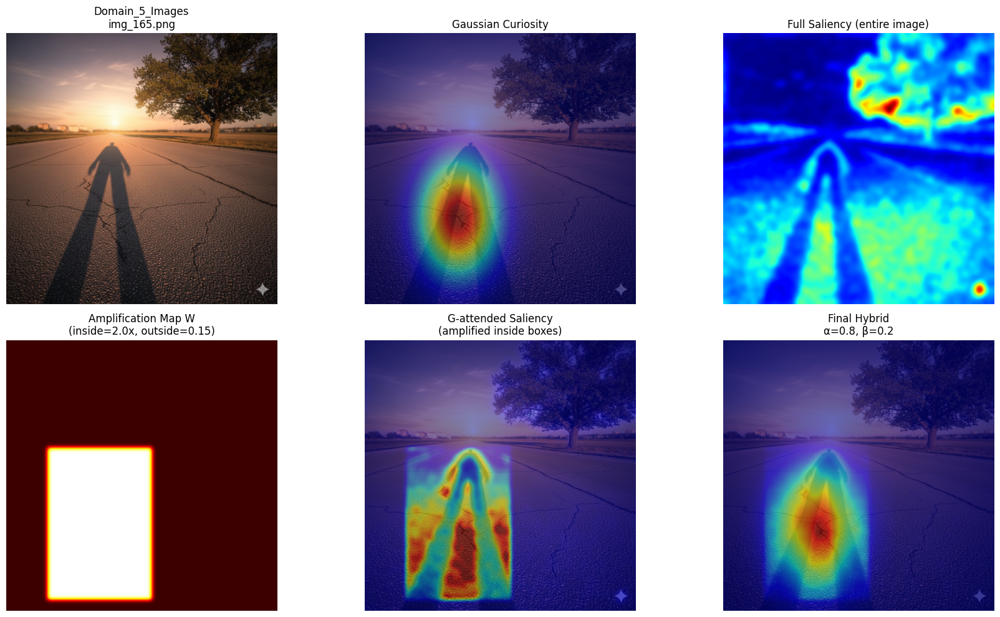

In [20]:
# Process 5 images per domain and visualize

domains = [
    'Domain_1_Images',
    'Domain_2_Images',
    'Domain_3_Images',
    'Domain_4_Images',
    'Domain_5_Images',
]

alpha, beta, lambda_out, boost = 0.8, 0.2, 0.15, 2.0

for domain in domains:
    print(f'Processing {domain} ...')
    items = load_domain_annotations(domain)
    items_sorted = sorted(items, key=lambda x: x['name'])[:5]

    for img_entry in items_sorted:
        img_path = Path(domain) / img_entry['name']
        img_rgb = cv2.cvtColor(cv2.imread(str(img_path)), cv2.COLOR_BGR2RGB)
        G, S, S_att, C, W = hybrid_curiosity(str(img_path), img_entry, 
                                            alpha=alpha, beta=beta, 
                                            lambda_out=lambda_out, 
                                            saliency_boost_inside=boost)

        fig, axes = plt.subplots(2, 3, figsize=(18, 10))
        # Row 1: Components
        axes[0,0].imshow(img_rgb); axes[0,0].set_title(f'{domain}\n{img_entry["name"]}'); axes[0,0].axis('off')
        axes[0,1].imshow(img_rgb); axes[0,1].imshow(G, cmap='jet', alpha=0.5, vmin=0, vmax=1); axes[0,1].set_title('Gaussian Curiosity'); axes[0,1].axis('off')
        axes[0,2].imshow(S, cmap='jet', vmin=0, vmax=1); axes[0,2].set_title('Full Saliency (entire image)'); axes[0,2].axis('off')
        
        # Row 2: Amplification and results
        axes[1,0].imshow(W, cmap='hot', vmin=0, vmax=boost); axes[1,0].set_title(f'Amplification Map W\n(inside={boost:.1f}x, outside={lambda_out:.2f})'); axes[1,0].axis('off')
        axes[1,1].imshow(img_rgb); axes[1,1].imshow(S_att, cmap='jet', alpha=0.5, vmin=0, vmax=1); axes[1,1].set_title('G-attended Saliency\n(amplified inside boxes)'); axes[1,1].axis('off')
        axes[1,2].imshow(img_rgb); axes[1,2].imshow(C, cmap='jet', alpha=0.6, vmin=0, vmax=1); axes[1,2].set_title(f'Final Hybrid\nα={alpha}, β={beta}'); axes[1,2].axis('off')
        plt.tight_layout(); plt.show()
